# Imports

In [1]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt
import random

# Loading Images

In [2]:
# Images folder path
imgs_path = 'imgs/'

In [3]:
def load_stereo_imgs(left_img_path, right_img_path):
    imgL = cv.imread(left_img_path, 0)
    imgR = cv.imread(right_img_path, 0)

    return imgL, imgR

In [4]:
img1L, img1R = load_stereo_imgs(imgs_path + 'l1.png', imgs_path + 'r1.png')
img2L, img2R = load_stereo_imgs(imgs_path + 'l2.png', imgs_path + 'r2.png')
img3L, img3R = load_stereo_imgs(imgs_path + 'l3.png', imgs_path + 'r3.png')

# Sample Run

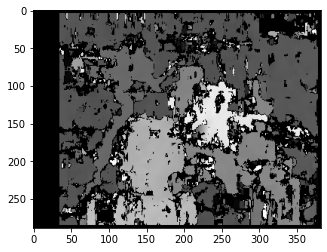

In [5]:
stereo = cv.StereoBM_create(numDisparities = 32, blockSize = 9)
disparity = stereo.compute(img1L, img1R)
plt.imshow(disparity, 'gray')
plt.show()

# 1.1.2 Dynamic programming

In [7]:
def matching_cost(I1, I2, sigma):
    return (int(I1) - int(I2)) ** 2 / sigma ** 2

def dynamic_prog_disparity(left_img, right_img, sigma, c0):
    assert left_img.shape == right_img.shape
    assert left_img.ndim == 2
    assert right_img.ndim == 2
    assert sigma != 0
    assert c0 >= 0

    disparityl = np.zeros(left_img.shape)
    disparityr = np.zeros(right_img.shape)
    D_matrices = [] # it will be used in the bonus part
    
    # loop on the image rows
    for r in range(left_img.shape[0]):
        D = np.zeros((len(left_img[r]), len(left_img[r])), dtype=np.float32)

        # prepare the first row and column of D matrix
        for i in range(0, D.shape[0]):
            D[i, 0] = i * c0
            D[0, i] = i * c0
        D[1, 1] = matching_cost(left_img[r, 0], right_img[r, 0], sigma)

        # computing table step
        for i in range(1, D.shape[0]):
            for j in range(1, D.shape[1]):
                match_cost = matching_cost(left_img[r, i], right_img[r, j], sigma)
                D[i, j] = min(D[i - 1, j - 1] + match_cost , min(D[i - 1, j], D[i, j - 1]) + c0)

        # backtracking step
        i = D.shape[0] - 1
        j = D.shape[1] - 1
        while (i > 0 and j > 0):
            '''
            You can construct the disparity matrix and prepare the D matrix to be ploted in the bonus part by these steps:
            1 - choose the minimum value of D from (i - 1, j - 1), (i - 1, j), (i, j - 1)
            2- Selecting (i - 1, j) corresponds to skipping a pixel in Il, so the left disparity map of i is zero 
            (set the pixel (i - 1, j) with the value -1 to be recognized in the bonus part)
            3- Selecting (i, j - 1) corresponds to skipping a pixel in Ir, and the right disparity map of j is zero
            (set the pixel (i, j - 1) with the value -1 to be recognized in the bonus part)
            4- Selecting (i - 1, j - 1) matches pixels (i, j) and therefore both disparity maps at this position are set to the
            absolute difference between i and j
            (set the pixels (i, j) with the value -1 to be recognized in the bonus part)
            '''
            D[i, j] = -1
            if D[i - 1, j] < D[i - 1, j - 1] and D[i - 1, j] < D[i, j - 1]:
                i -= 1
            elif D[i, j - 1] < D[i - 1, j - 1] and D[i, j - 1] < D[i - 1, j]:
                j -= 1
            else:
                disparity = np.absolute(i - j)
                disparityl[r, i - 1] = disparity
                disparityr[r, j - 1] = disparity
                i -= 1
                j -= 1
        
        D[i, j] = -1
        D_matrices.append(D)
    
    return disparityl, disparityr, D_matrices

In [8]:
# Constants
sigma = 2
c0 = 1

## First Image

In [9]:
# Apply Occlusion With c0 = 1
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, sigma, c0)

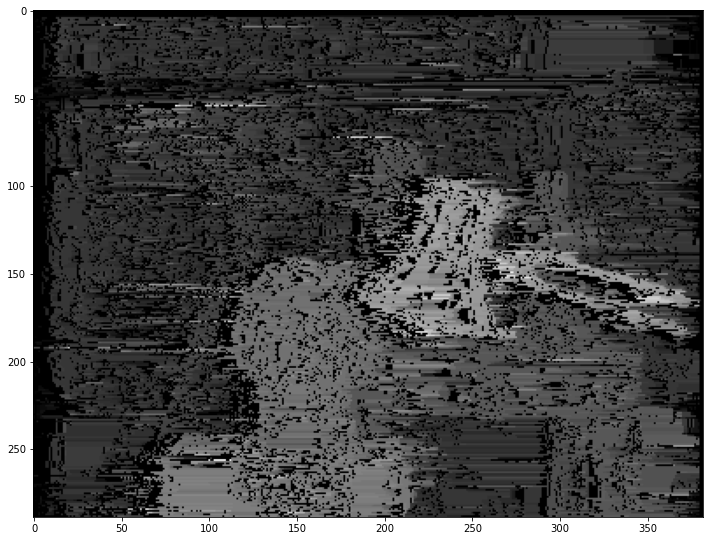

In [10]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

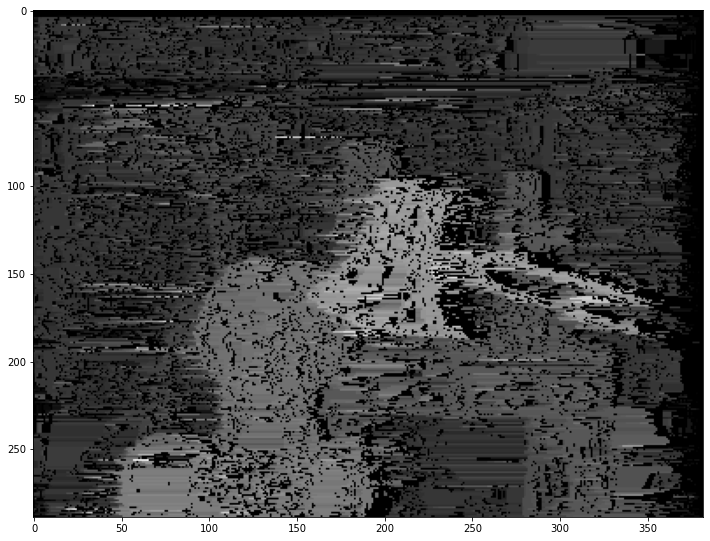

In [11]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [12]:
# Apply Occlusion With c0 = 5
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, sigma, 10)

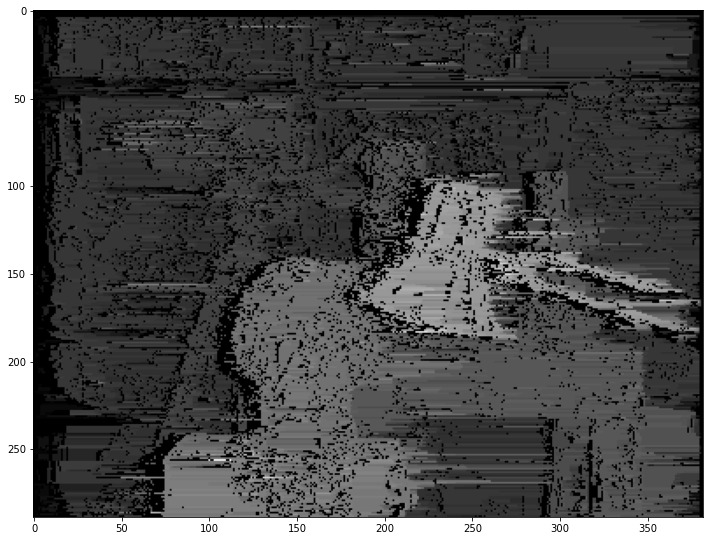

In [13]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

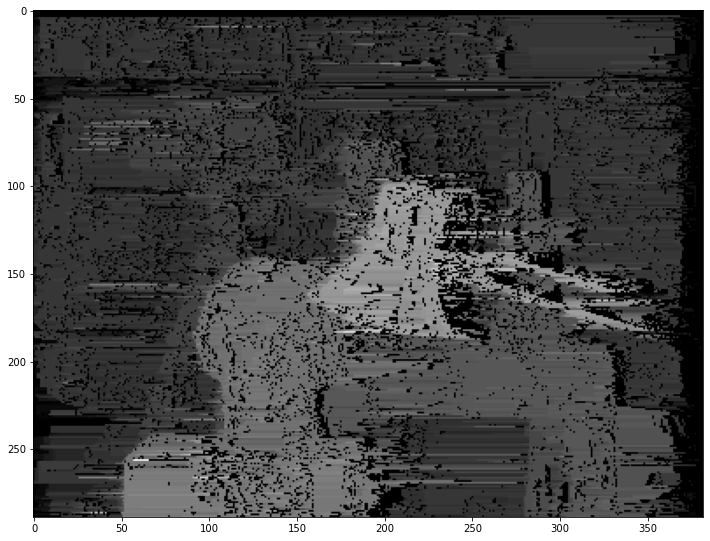

In [14]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [15]:
# Apply Occlusion With c0 = 20
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, 4, c0)

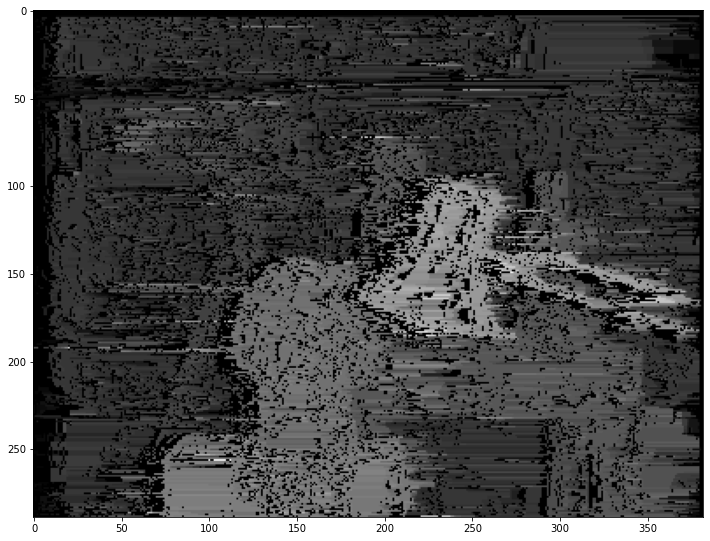

In [16]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

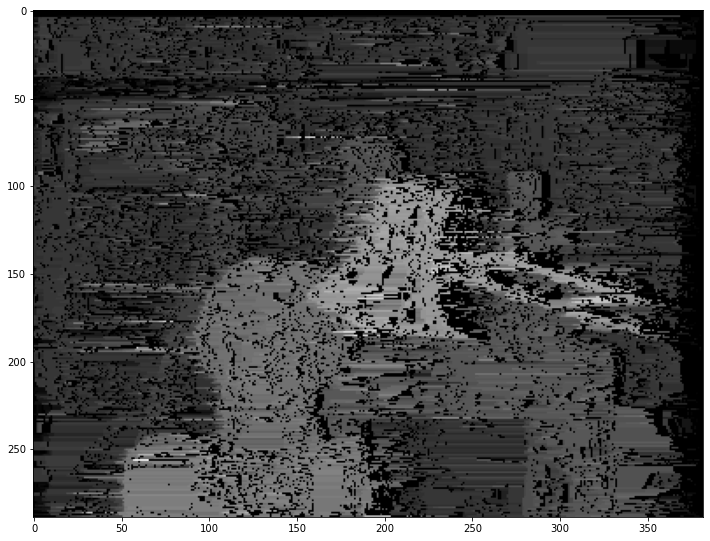

In [17]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [48]:
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, 0.5, c0)


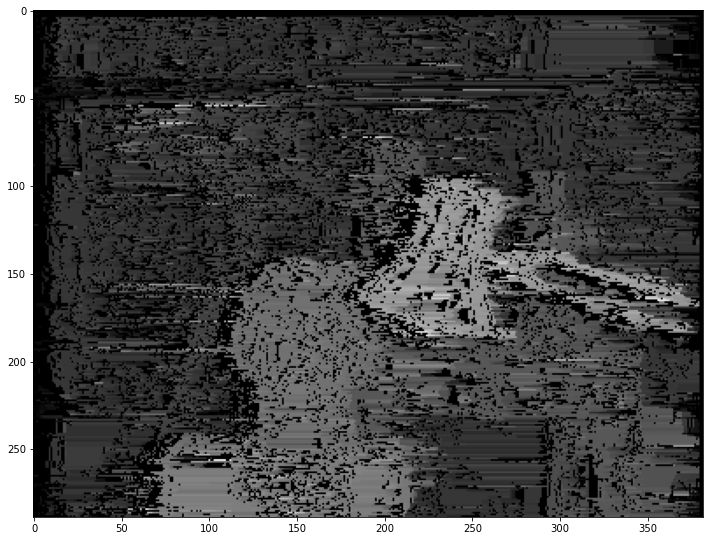

In [49]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

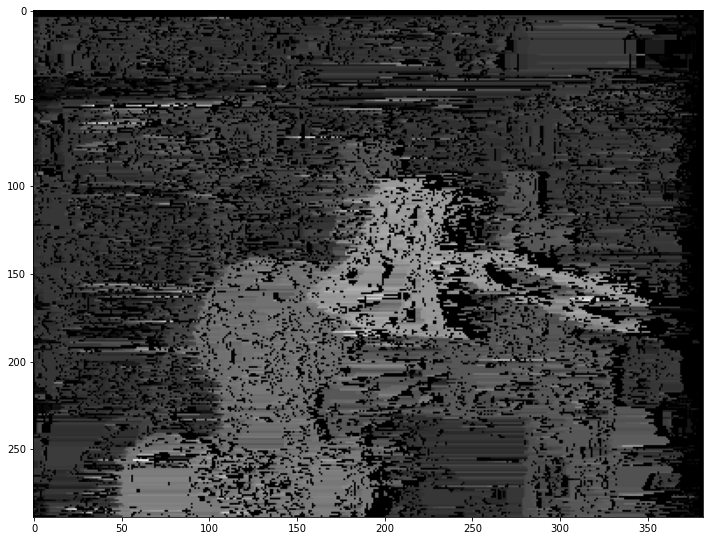

In [50]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [18]:
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, 4, 10)

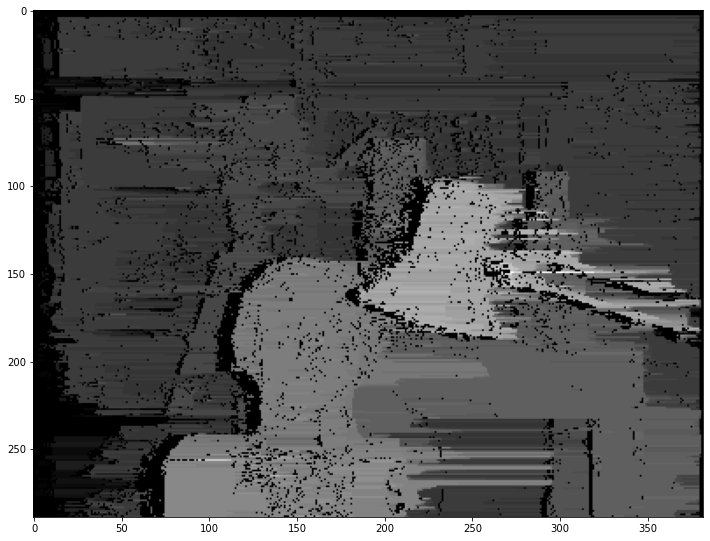

In [19]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

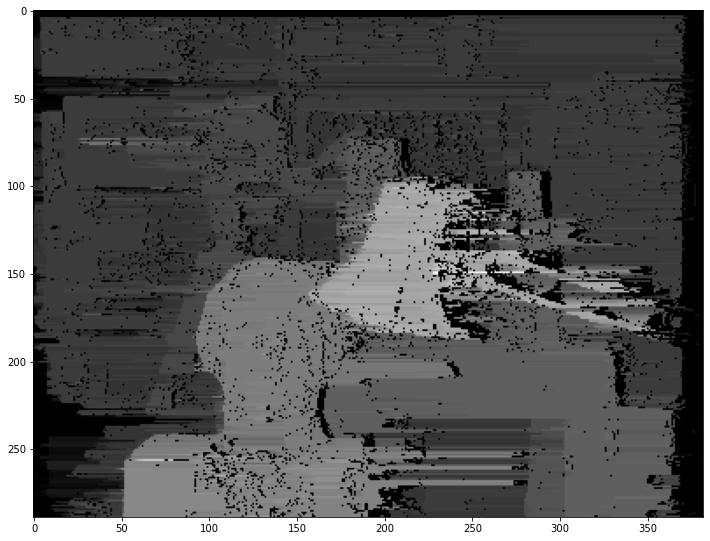

In [20]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [21]:
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, 0.5, 10)

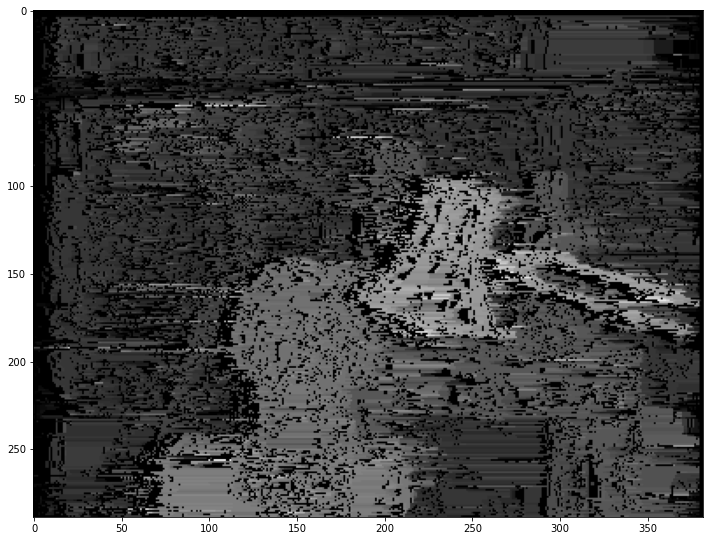

In [22]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

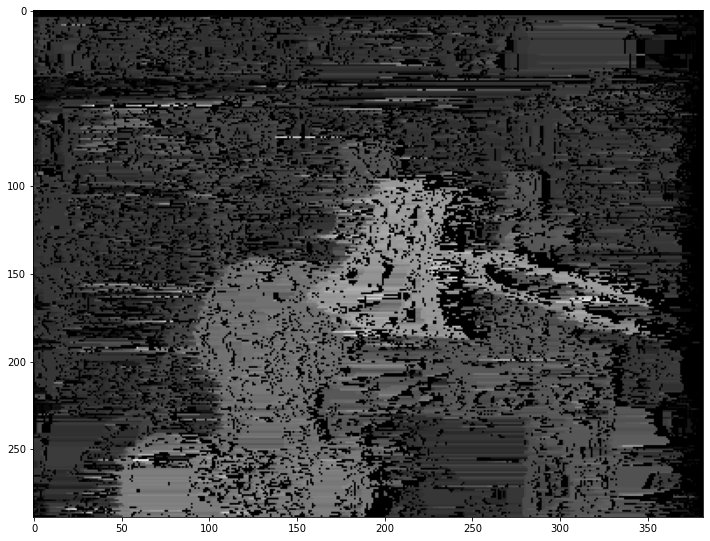

In [23]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [24]:
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, sigma, 20)


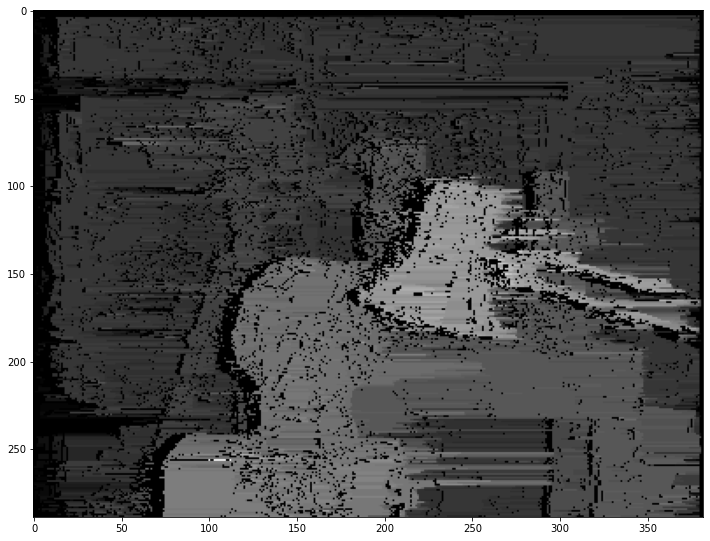

In [25]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

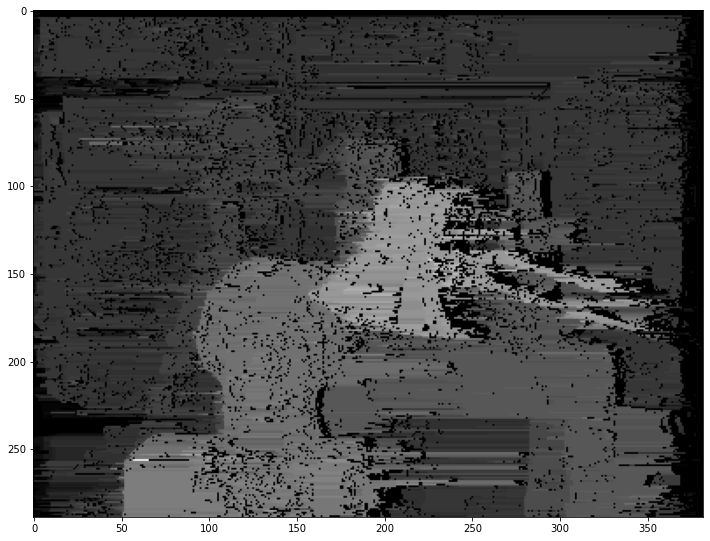

In [26]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [81]:
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, 4, 20)

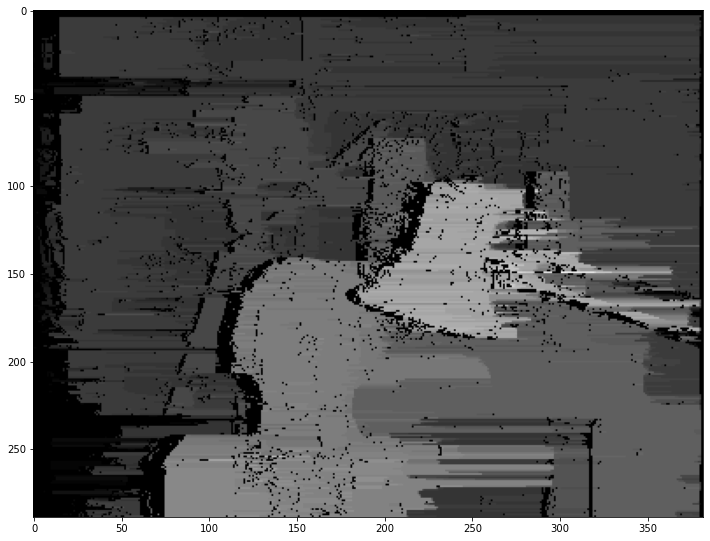

In [82]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

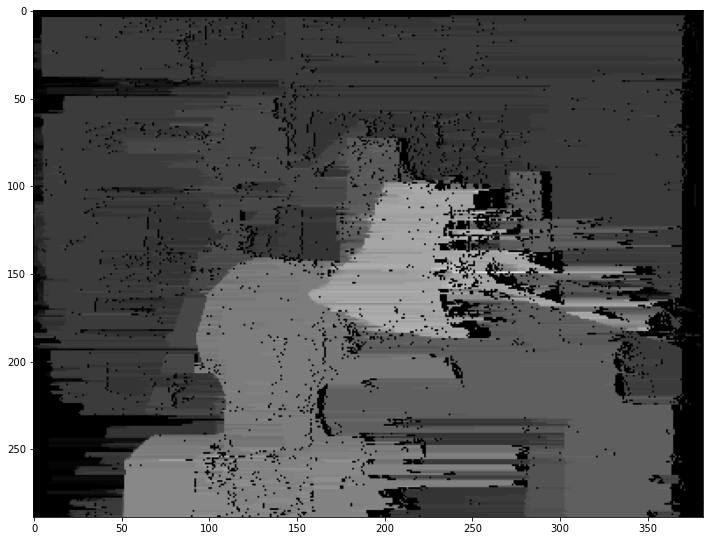

In [83]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

In [84]:
img1_disparityl, img1_disparityr, img1_D_matrices = dynamic_prog_disparity(img1L, img1R, 0.5, 20)


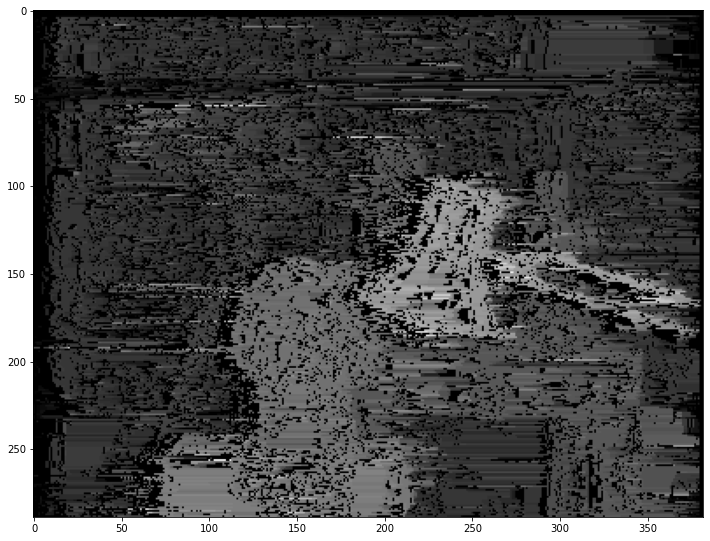

In [85]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityl, 'gray')

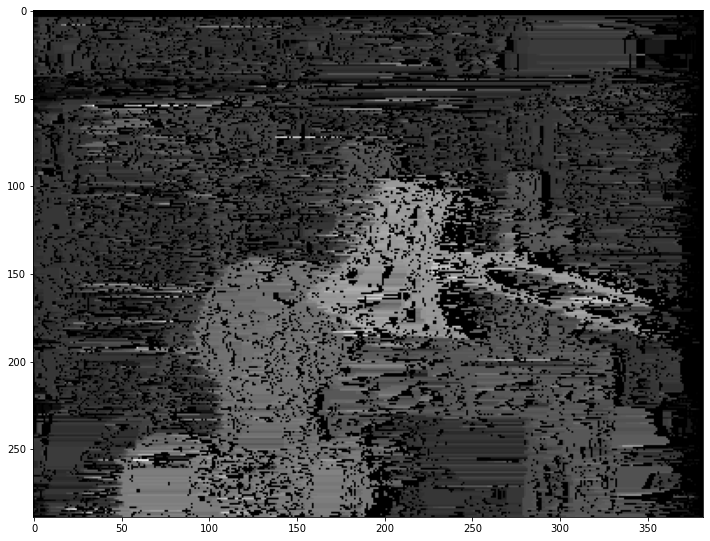

In [86]:
plt.figure(figsize=(12, 12))
plt.imshow(img1_disparityr, 'gray')

## Second Image 

In [27]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, sigma, c0)

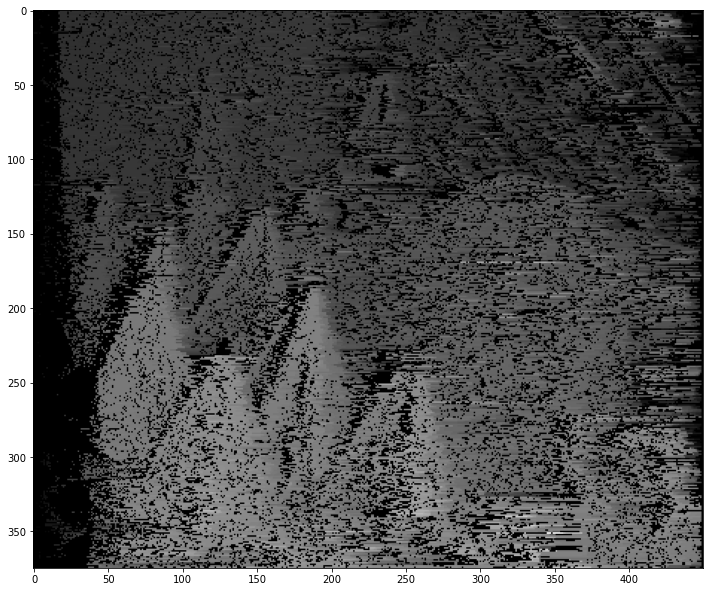

In [28]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

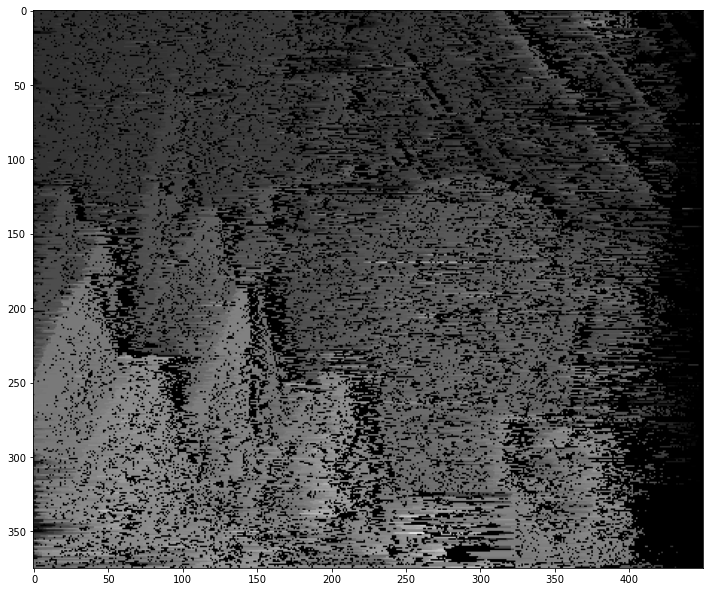

In [29]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [30]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, sigma, 10)

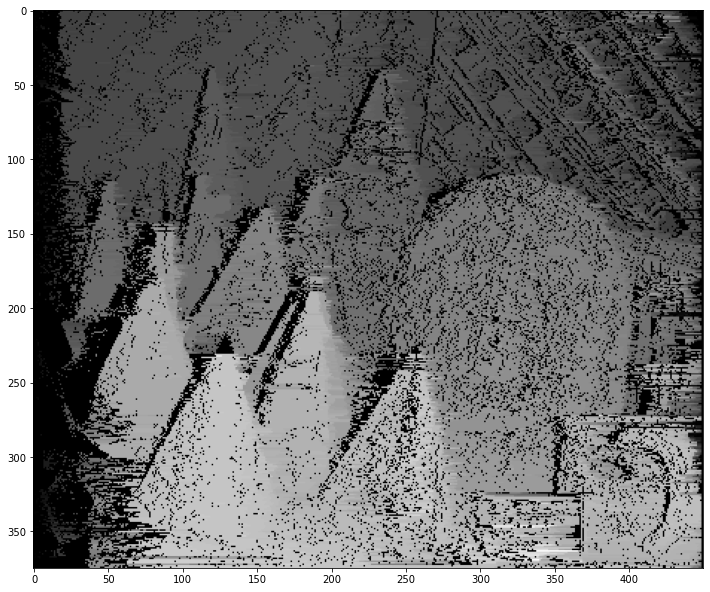

In [31]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

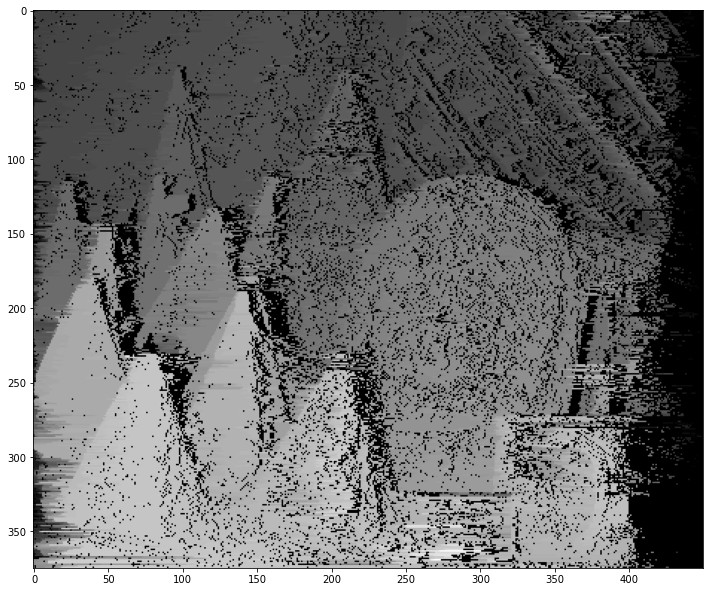

In [32]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [33]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, 4, c0)

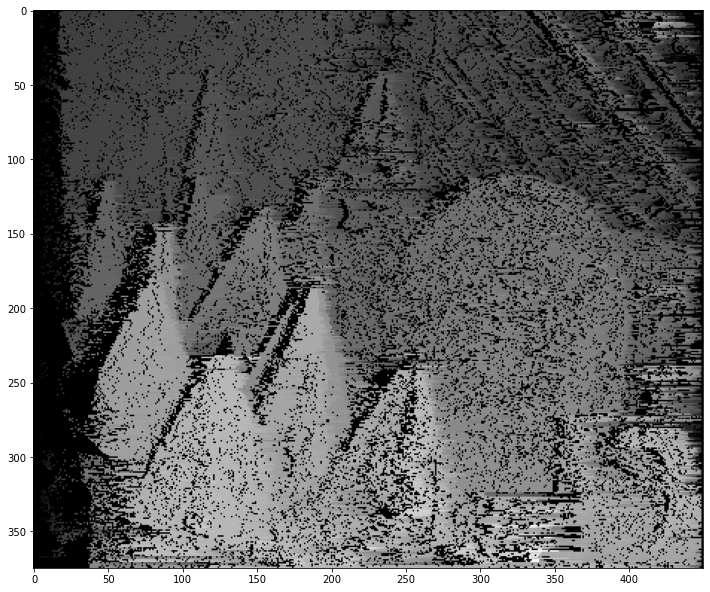

In [34]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

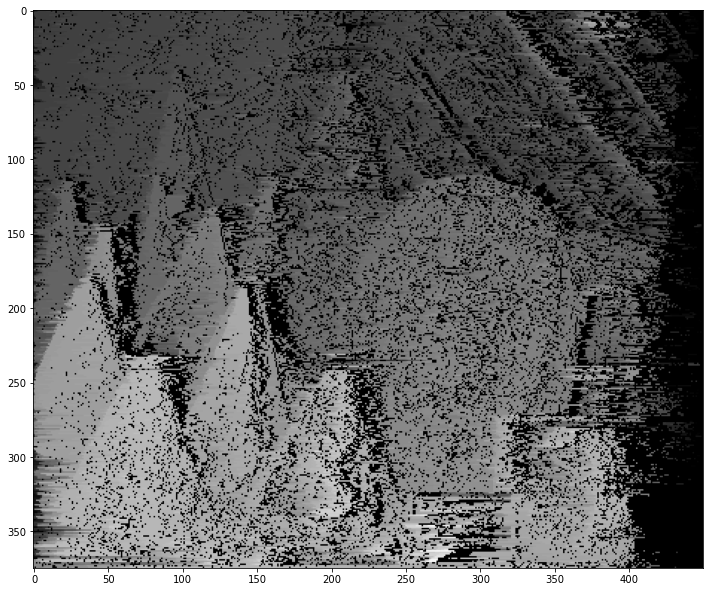

In [35]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [36]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, 0.5, c0)

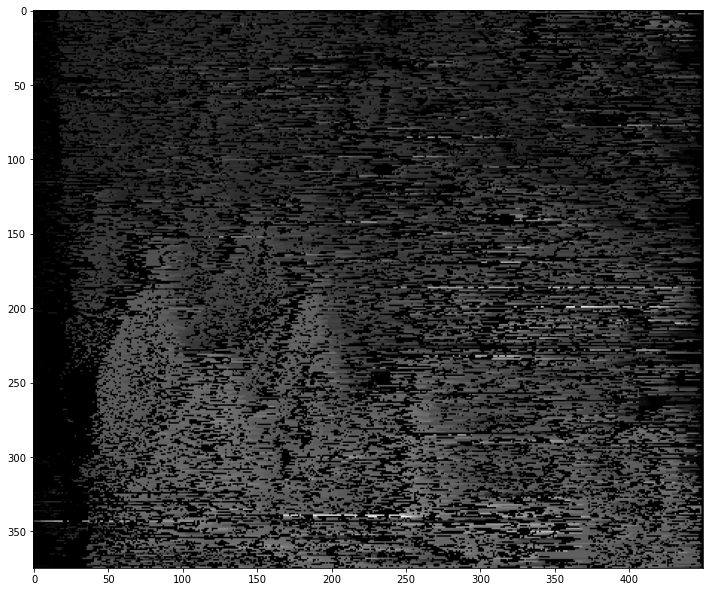

In [37]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

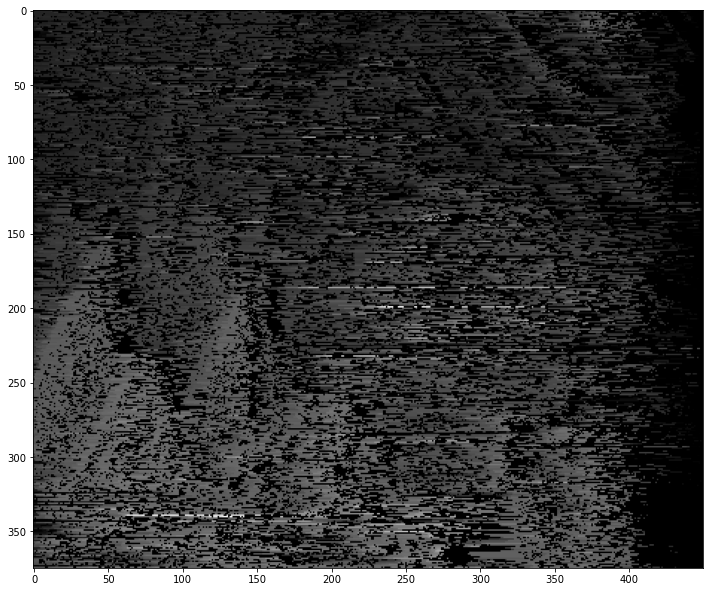

In [38]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [39]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, 0.5, 10)

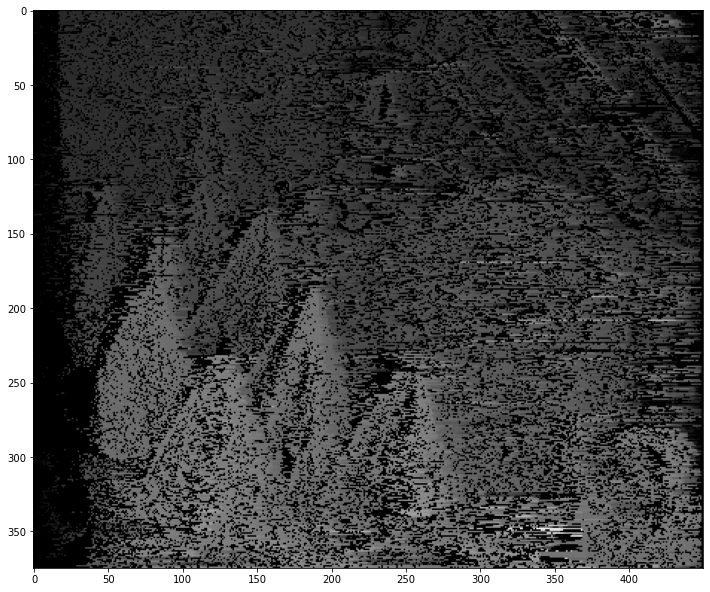

In [40]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

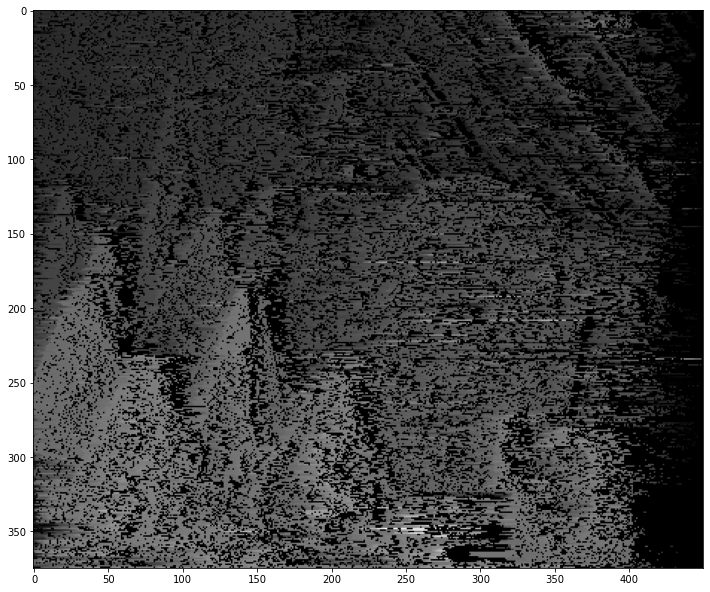

In [41]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [42]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, 4, 10)

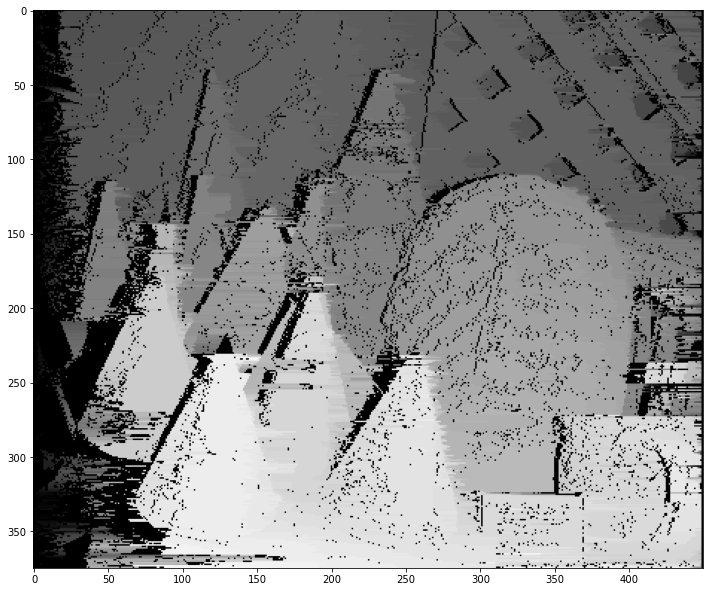

In [43]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

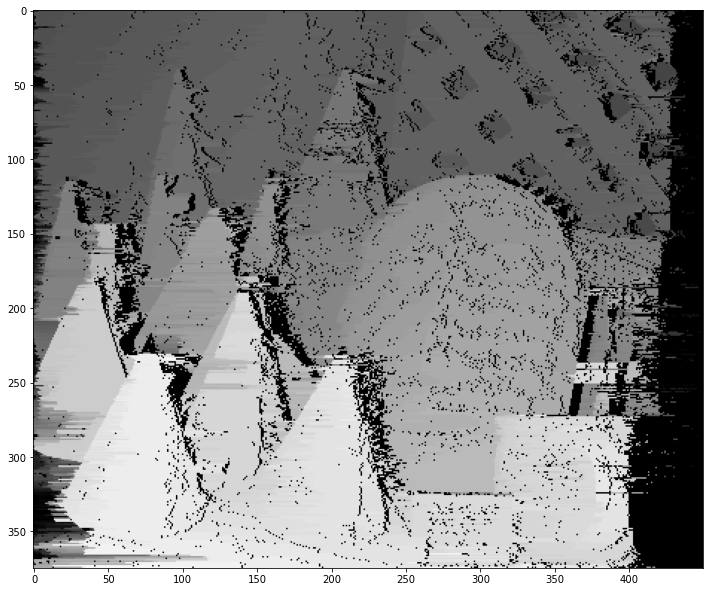

In [44]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [45]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, sigma, 20)

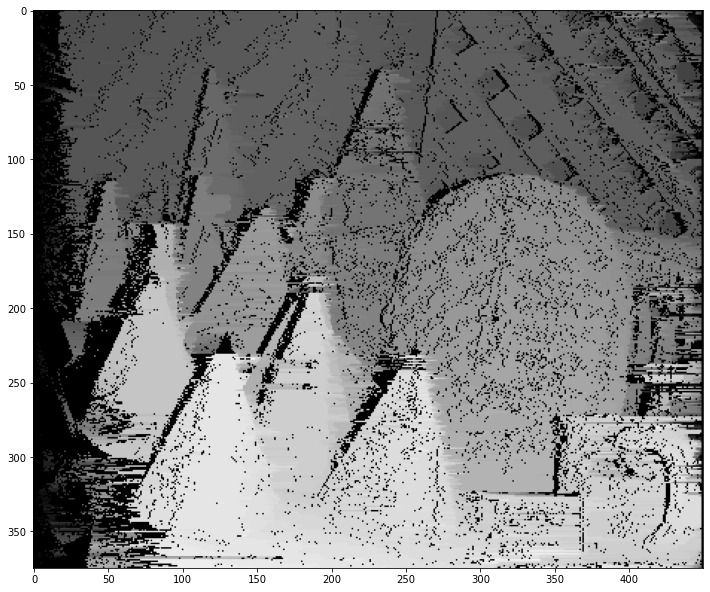

In [46]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

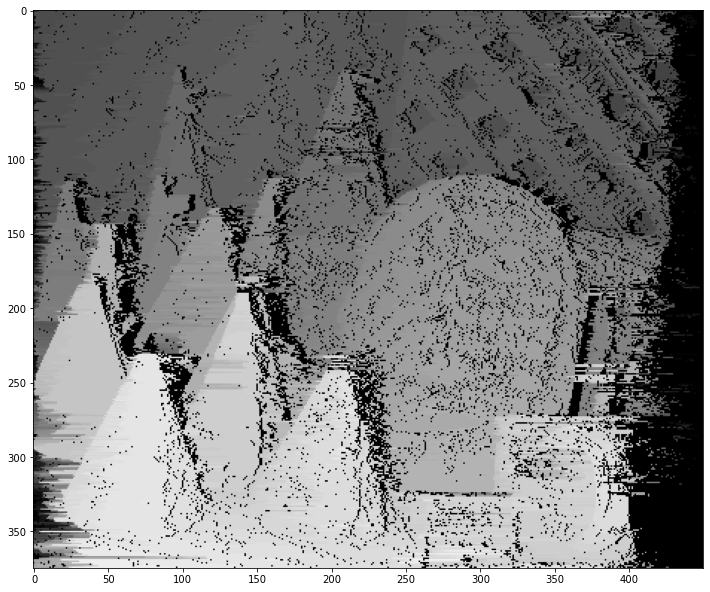

In [47]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [78]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, 4, 20)

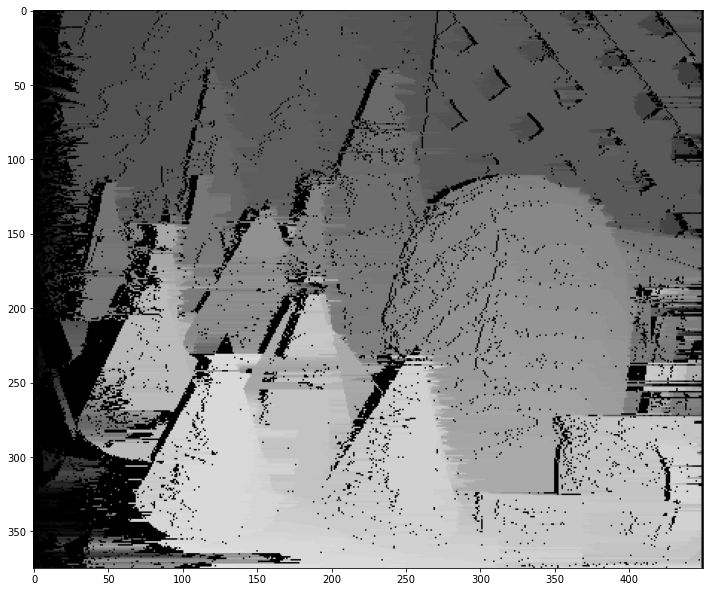

In [79]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

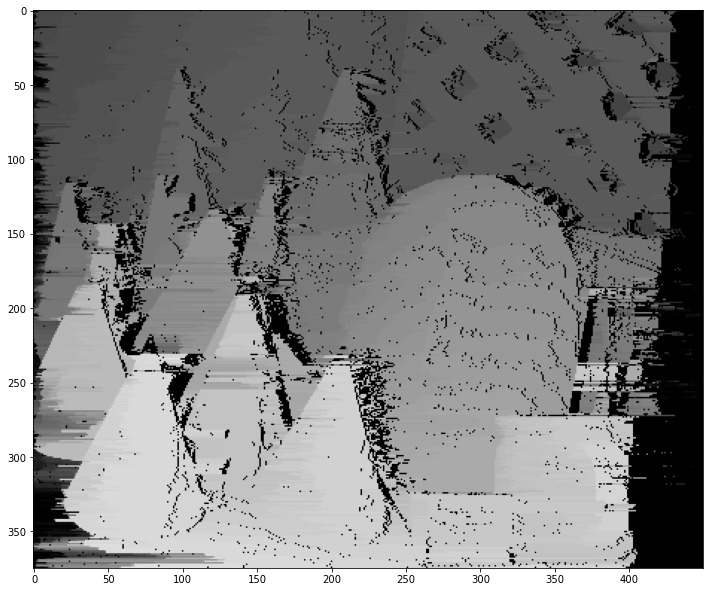

In [80]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

In [87]:
img2_disparityl, img2_disparityr, img2_D_matrices = dynamic_prog_disparity(img2L, img2R, 0.5, 20)

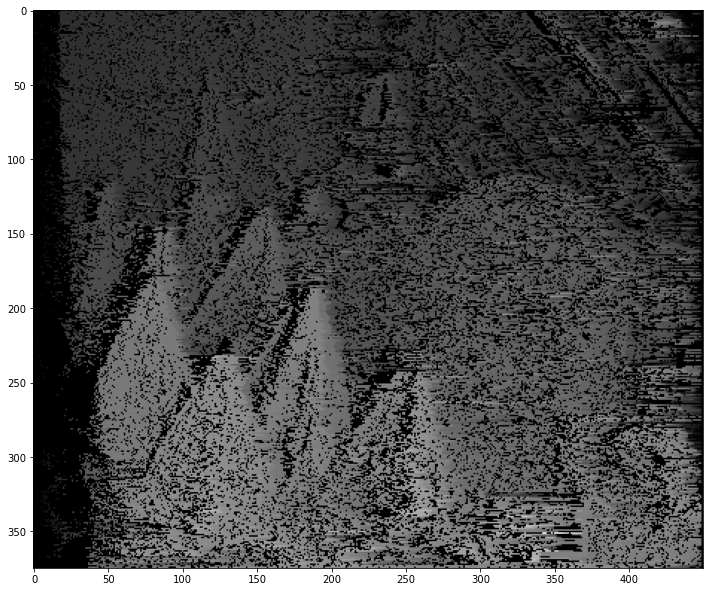

In [88]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityl, 'gray')

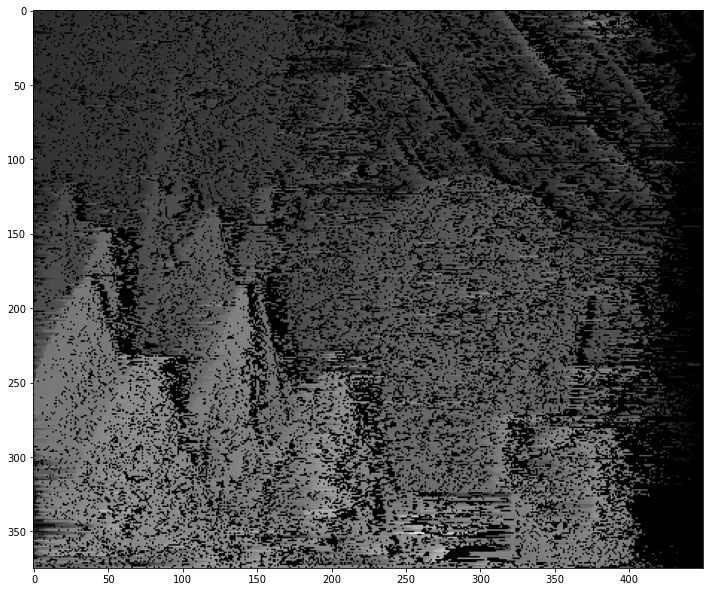

In [89]:
plt.figure(figsize=(12, 12))
plt.imshow(img2_disparityr, 'gray')

## Third Image

In [51]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, sigma, c0)

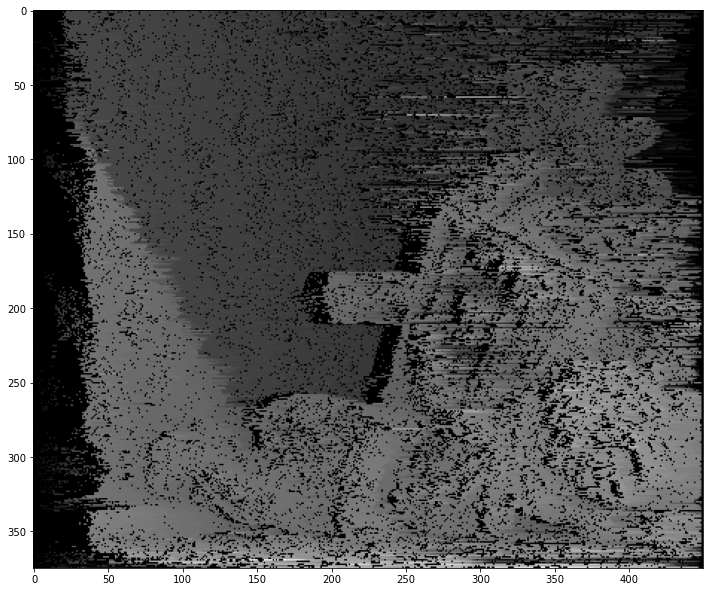

In [52]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

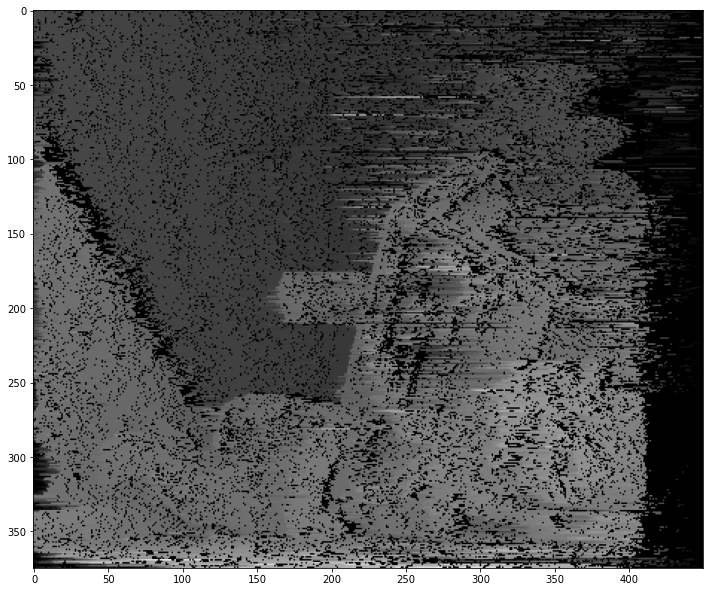

In [53]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [54]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, sigma, 10)

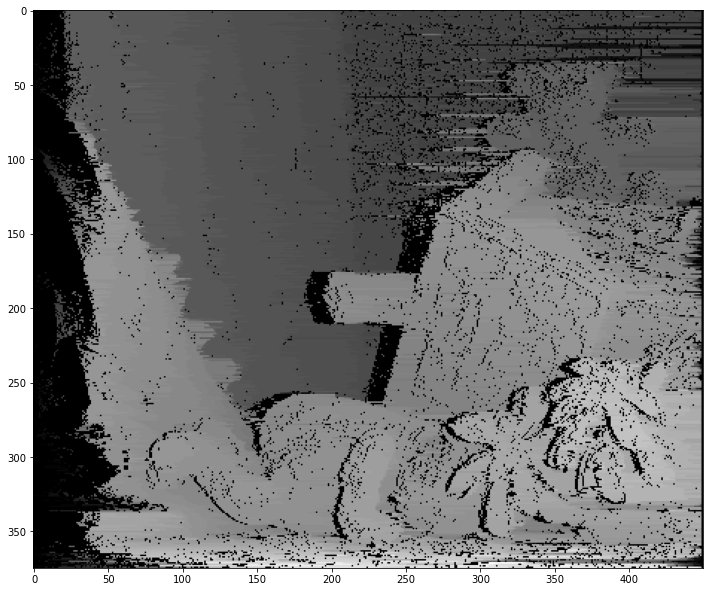

In [55]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

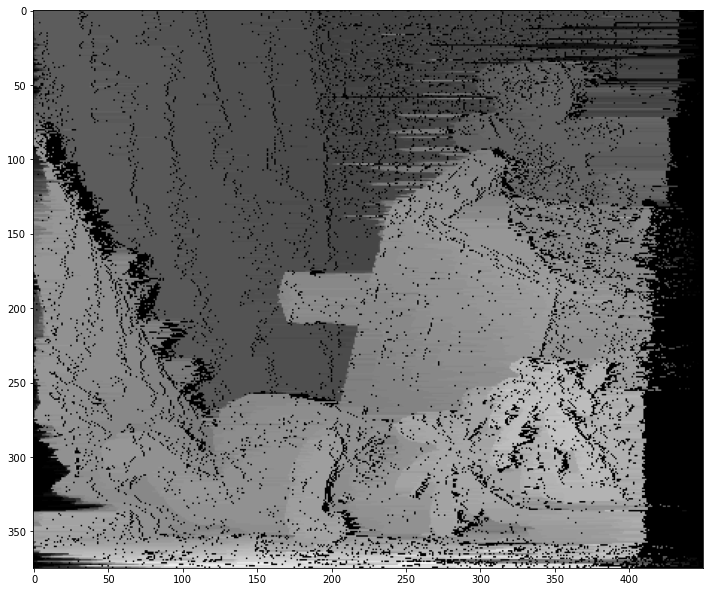

In [56]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [57]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, 0.5, c0)

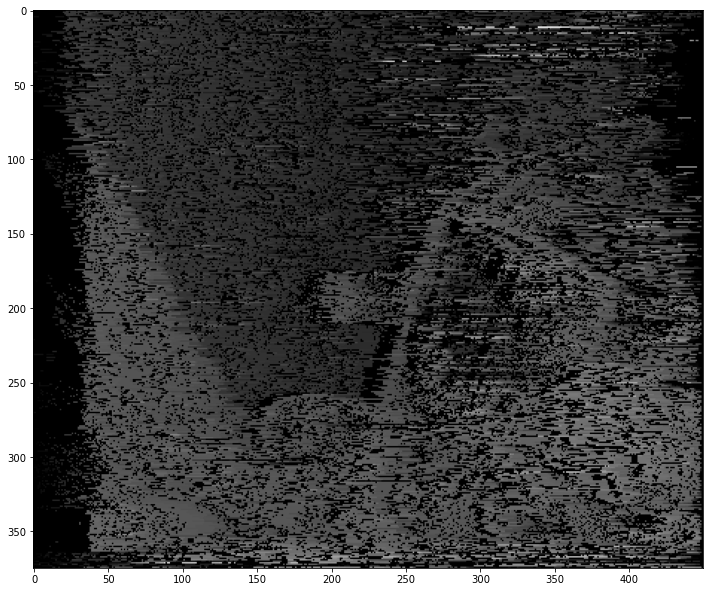

In [58]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

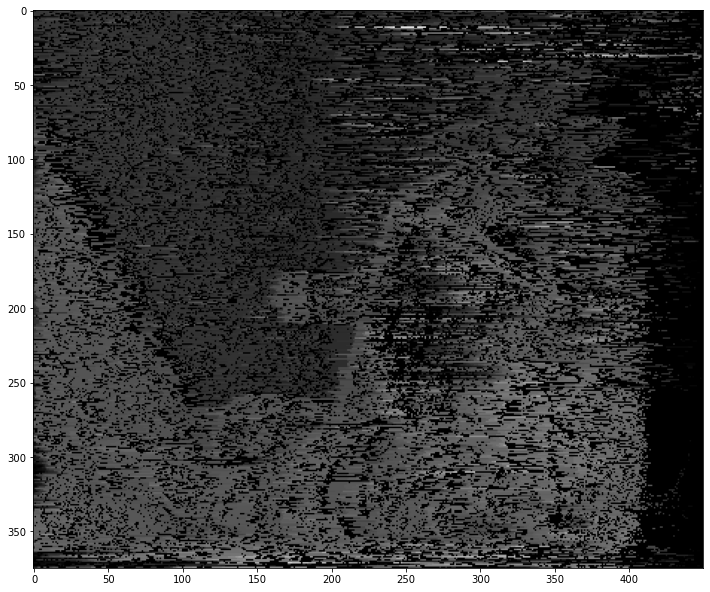

In [59]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [60]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, 4, c0)

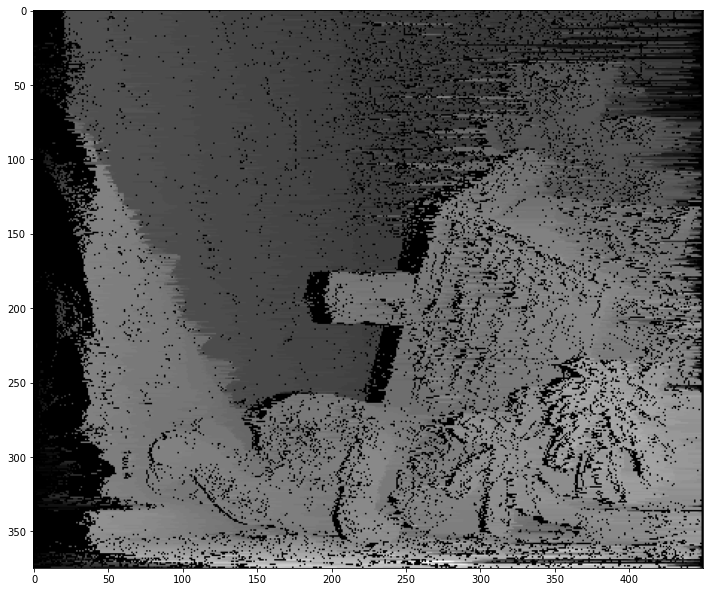

In [61]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

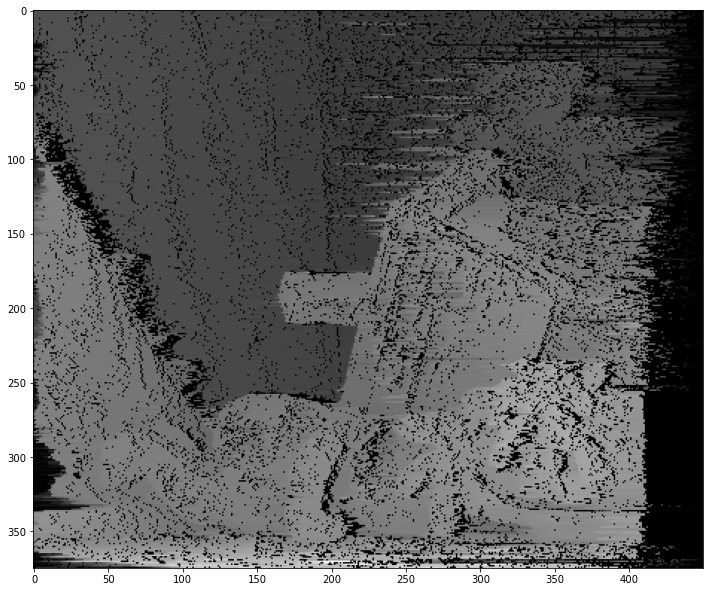

In [62]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [63]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, 0.5, 10)

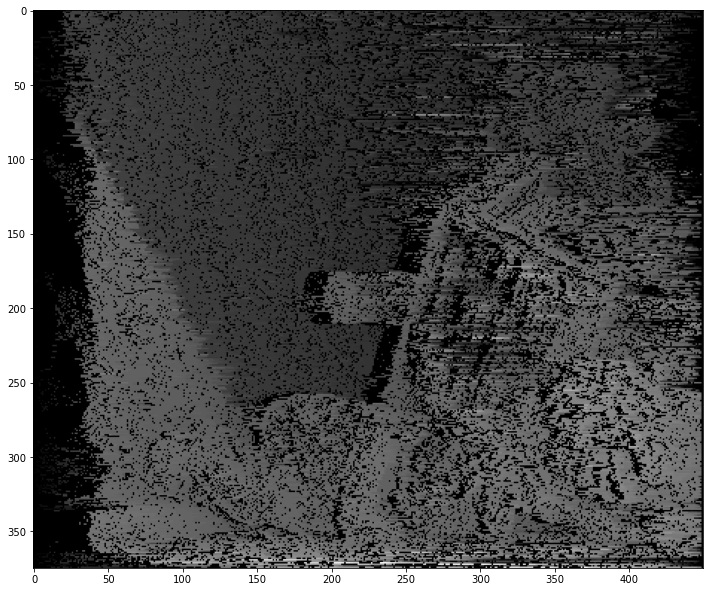

In [64]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

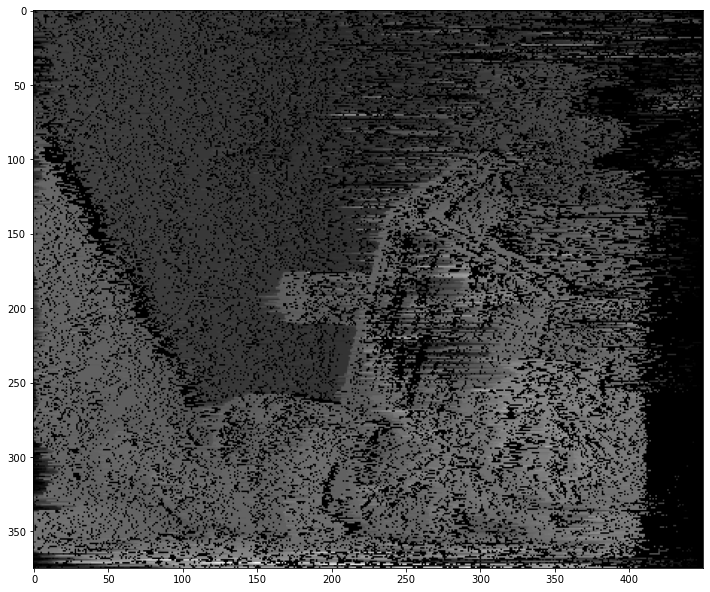

In [65]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [66]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, 4, 10)

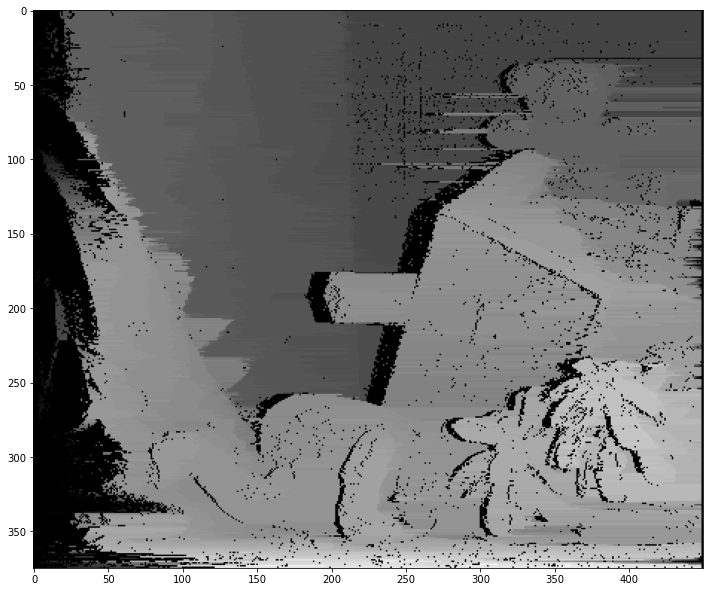

In [67]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

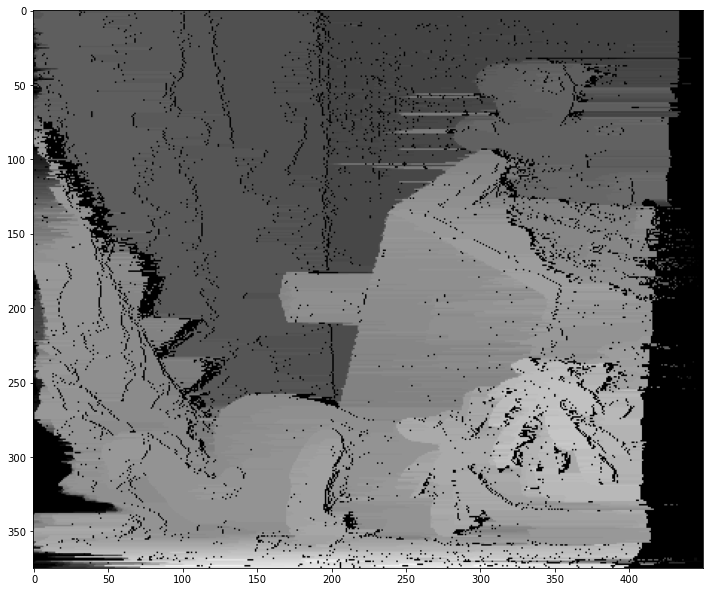

In [68]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [69]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, sigma, 20)

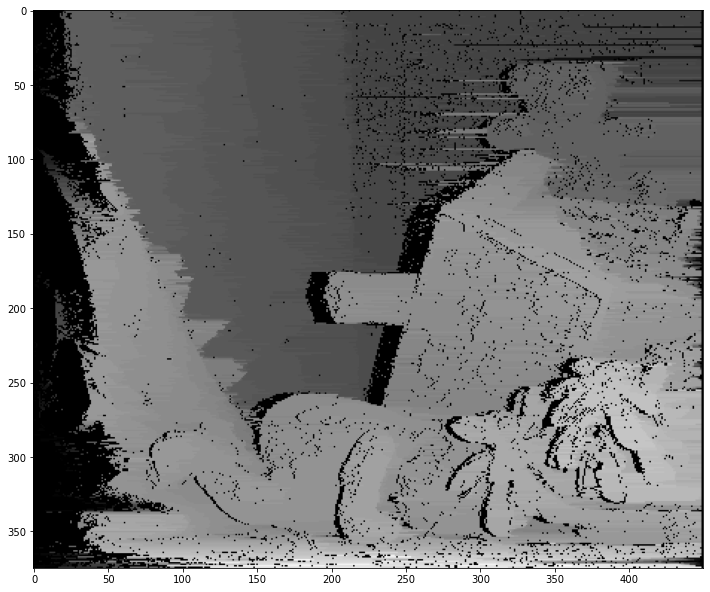

In [70]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

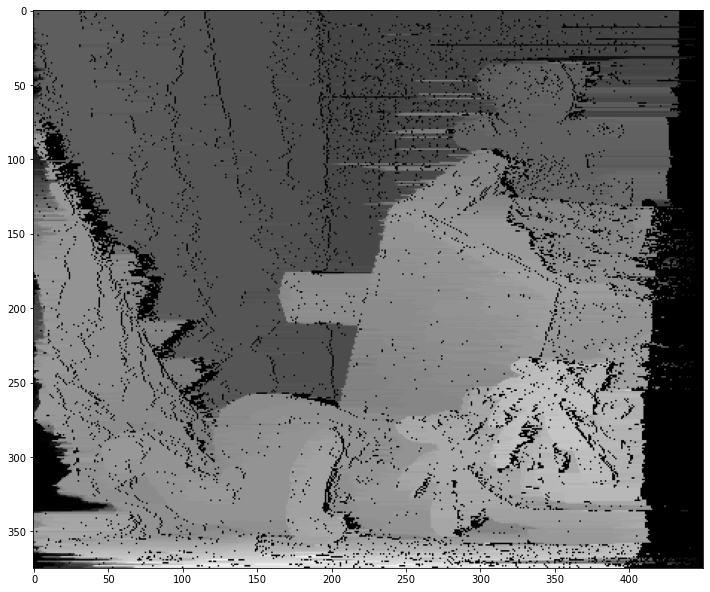

In [71]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [75]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, 4, 20)

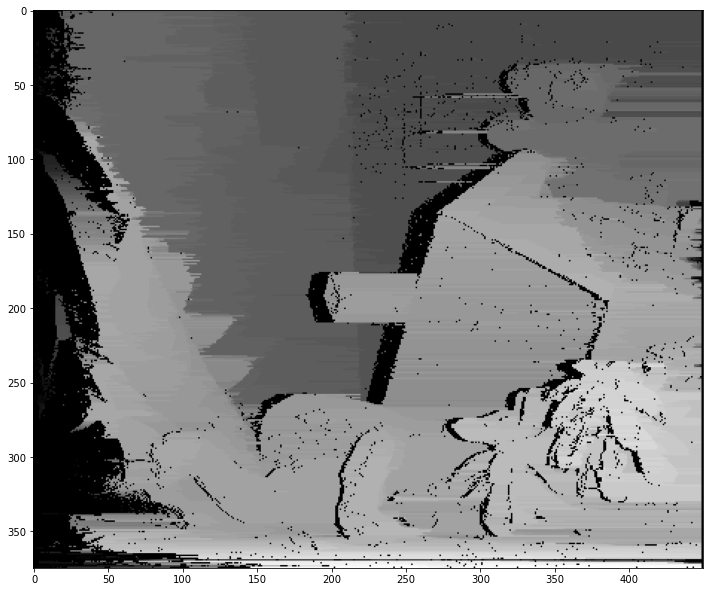

In [76]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

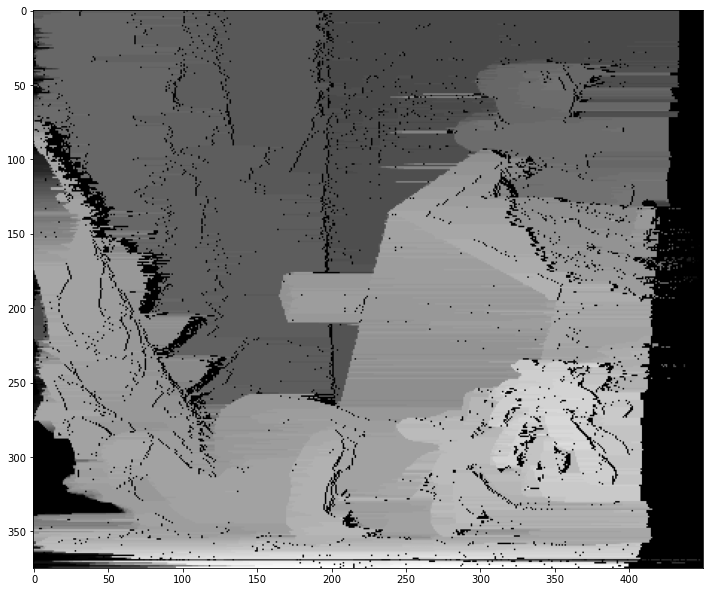

In [77]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

In [90]:
img3_disparityl, img3_disparityr, img3_D_matrices = dynamic_prog_disparity(img3L, img3R, 0.5, 20)


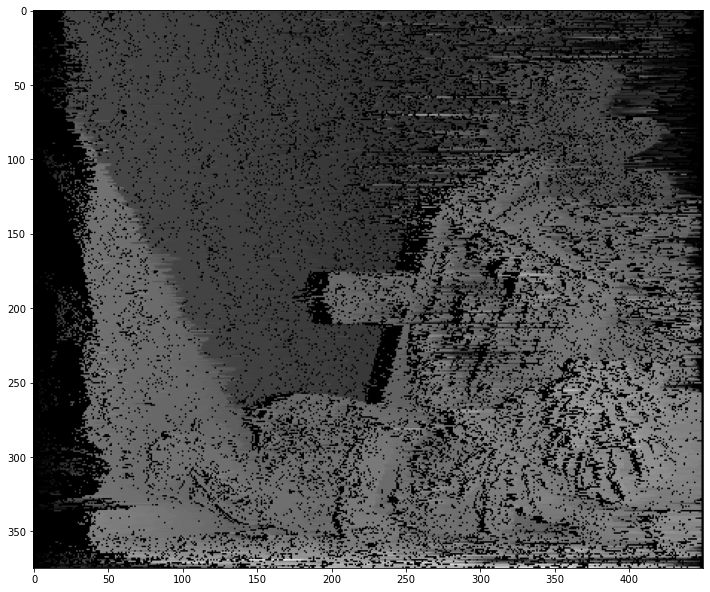

In [91]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityl, 'gray')

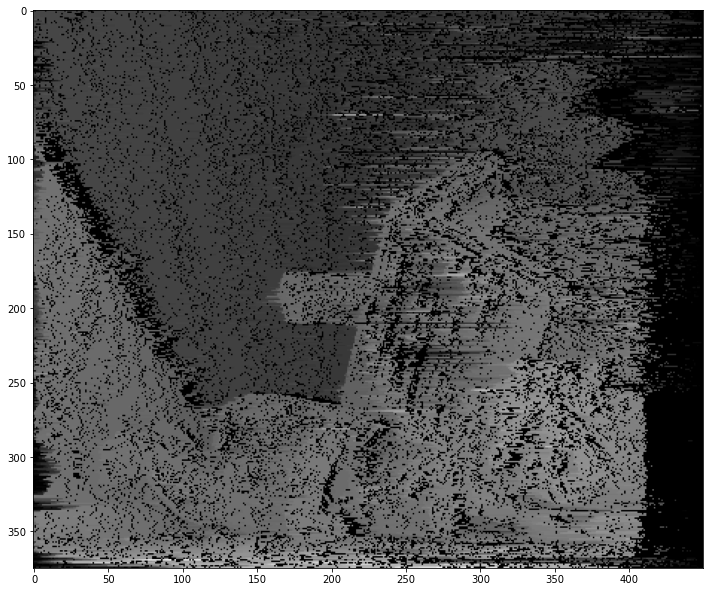

In [92]:
plt.figure(figsize=(12, 12))
plt.imshow(img3_disparityr, 'gray')

# 1.2 Bonus

In [65]:
# Plot one of the D_matrices for every test image (D_matrices should be pre-prepared)
# For every line pixel(i, j) the value of the pixle in D(i, j) will equal -1
# For every non-line pixel(i, j) the value of the pixel in D(i, j) will not equal -1

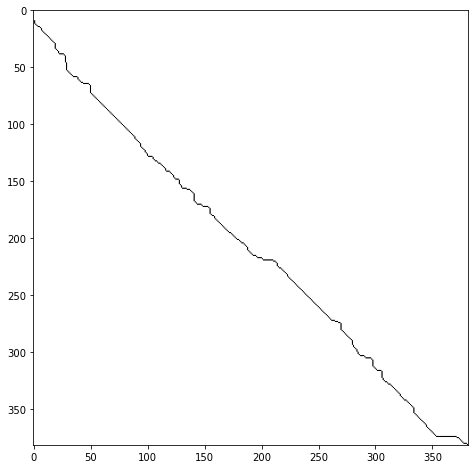

In [72]:
_, thresh1 = cv.threshold(img1_D_matrices[random.randint(0,len(img1_D_matrices) - 1)], 0, 255, cv.THRESH_BINARY)
plt.figure(figsize=(8, 8))
plt.imshow(thresh1, 'gray')

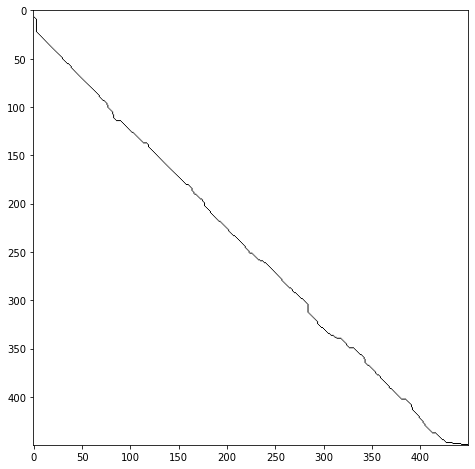

In [73]:
_, thresh2 = cv.threshold(img2_D_matrices[random.randint(0,len(img2_D_matrices) - 1)], 0, 255, cv.THRESH_BINARY)
plt.figure(figsize=(8, 8))
plt.imshow(thresh2, 'gray')

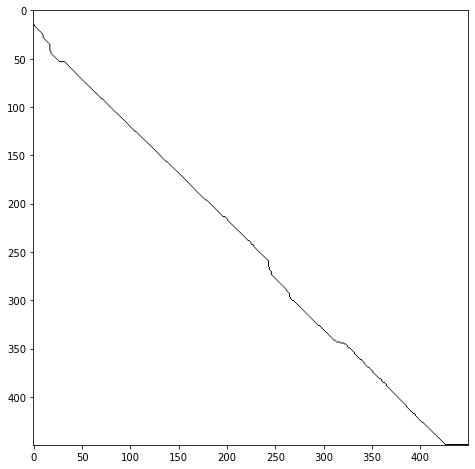

In [74]:
_, thresh3 = cv.threshold(img3_D_matrices[random.randint(0,len(img3_D_matrices) - 1)], 0, 255, cv.THRESH_BINARY)
plt.figure(figsize=(8, 8))
plt.imshow(thresh3, 'gray')